# Training the neural network
Please only do this once you've run `main.py` and download the files and press the save button, as this relys on having the savestate avaliable

In [1]:
# Get savestate
from pickle import load
with open('cache/savestate.pkl', 'rb') as f:
    files = load(f)

files

{'Names':      Location    State                                   Name      Lat  \
 0       15590       NT                  ALICE SPRINGS AIRPORT -23.7951   
 1       14272       NT                      BATCHELOR AIRPORT -13.0544   
 2       14723       NT                     BORROLOOLA AIRPORT -16.0755   
 3       14954       NT                               BRADSHAW -14.9408   
 4       14808       NT  BRADSHAW - ANGALLARI VALLEY (DEFENCE) -15.4397   
 ..        ...      ...                                    ...      ...   
 645     92037  Unknown                 SWAN ISLAND LIGHTHOUSE -40.7300   
 646     94061  Unknown                     SANDFORD (MAYDENA) -42.9300   
 647     94063  Unknown                       SORELL (WHITLEA) -42.7900   
 648     95016  Unknown                               OSTERLEY -42.3400   
 649     99001  Unknown                            DEAL ISLAND -39.4800   
 
          Long  
 0    133.8890  
 1    131.0252  
 2    136.3041  
 3    130.8091  
 4  

Borrowed code from https://github.com/mumarse/Sin_Wave_Prediction/blob/master/RNN-LSTM-SineWave.ipynb

([<matplotlib.lines.Line2D at 0x21747bef210>],
           Sine
 0.0   0.000000
 0.1   0.099833
 0.2   0.198669
 0.3   0.295520
 0.4   0.389418
 ...        ...
 49.6 -0.617439
 49.7 -0.535823
 49.8 -0.448854
 49.9 -0.357400
 50.0 -0.262375
 
 [501 rows x 1 columns])

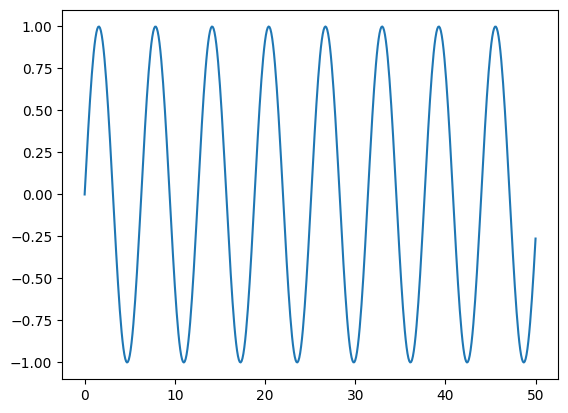

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# Generate the sin wave
x = np.linspace(0,50,501)
y = np.sin(x)
# Turn it into a dataframe
df = pd.DataFrame(data=y,index=x,columns=['Sine'])
# Plot it
plt.plot(x,y), df

In [6]:
# Split training and testing data
test_percent = 0.1
test_ind = int(len(df) - np.round(len(df)*test_percent))
train = df.iloc[:test_ind]
test = df.iloc[test_ind:]
full_scaler = MinMaxScaler()
scaled_full_data = full_scaler.fit_transform(df)
# IGNORE WARNING ITS JUST CONVERTING TO FLOATS
# WE ONLY FIT TO TRAININ DATA, OTHERWISE WE ARE CHEATING ASSUMING INFO ABOUT TEST SET
scaler.fit(train)
scaled_train = scaler.transform(train)
scaled_test = scaler.transform(test)
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
# define generator
length = 2 # Length of the output sequences (in number of timesteps)
batch_size = 1 #Number of timeseries samples in each batch
length = 50 # Length of the output sequences (in number of timesteps)
generator = TimeseriesGenerator(scaled_train, scaled_train, length=length, batch_size=1)
# What does the first batch look like?
X,y = generator[0]
print(f'Given the Array: \n{X.flatten()}')
print(f'Predict this y: \n {y}')

Given the Array: 
[4.99999116e-01 5.49916225e-01 5.99334579e-01 6.47760405e-01
 6.94709850e-01 7.39713809e-01 7.82322618e-01 8.22110545e-01
 8.58680040e-01 8.91665714e-01 9.20737985e-01 9.45606372e-01
 9.66022399e-01 9.81782075e-01 9.92727935e-01 9.98750612e-01
 9.99789928e-01 9.95835500e-01 9.86926839e-01 9.73152957e-01
 9.54651478e-01 9.31607263e-01 9.04250562e-01 8.72854714e-01
 8.37733417e-01 7.99237589e-01 7.57751870e-01 7.13690771e-01
 6.67494535e-01 6.19624741e-01 5.70559686e-01 5.20789614e-01
 4.70811810e-01 4.21125636e-01 3.72227539e-01 3.24606094e-01
 2.78737119e-01 2.35078919e-01 1.94067715e-01 1.56113277e-01
 1.21594831e-01 9.08572769e-02 6.42077324e-02 4.19124713e-02
 2.41942605e-02 1.12301346e-02 3.14962674e-03 3.34747619e-05
 1.91281421e-03 8.76886734e-03]
Predict this y: 
 [[0.02053313]]


In [7]:
# Create the model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,LSTM,SimpleRNN
# We're only using one feature in our time series
n_features = 1
# define model
model = Sequential()

# Simple RNN layer
model.add(SimpleRNN(50,input_shape=(length, n_features)))

# Final Prediction
model.add(Dense(1))

model.compile(optimizer='adam', loss='mse')

model.summary()

C:\Users\max.worrall\AppData\Roaming\Python\Python311\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ simple_rnn (SimpleRNN)          │ (None, 50)             │         2,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            51 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,651 (10.36 KB)

 Trainable params: 2,651 (10.36 KB)

 Non-trainable params: 0 (0.00 B)

In [9]:
# fit model
model.fit(generator,epochs=5)

Epoch 1/5
 50/401 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3259

C:\Users\max.worrall\AppData\Roaming\Python\Python311\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


401/401 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0748
Epoch 2/5
401/401 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0278e-04
Epoch 3/5
401/401 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4830e-04
Epoch 4/5
401/401 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.7305e-04
Epoch 5/5
401/401 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4683e-04


<Axes: >

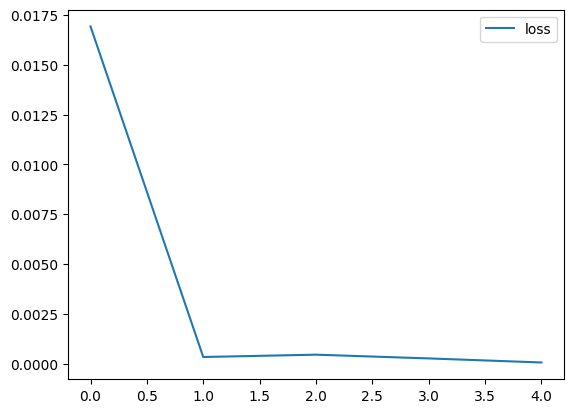

In [10]:
losses = pd.DataFrame(model.history.history)
losses.plot()

In [13]:
test_predictions = []

first_eval_batch = scaled_train[-length:]
current_batch = first_eval_batch.reshape((1, length, n_features))

for i in range(len(test)):
    
    # get prediction 1 time stamp ahead ([0] is for grabbing just the number instead of [array])
    current_pred = model.predict(current_batch)[0]
    
    # store prediction
    test_predictions.append(current_pred) 
    
    # update batch to now include prediction and drop first value
    current_batch = np.append(current_batch[:,1:,:],[[current_pred]],axis=1)
true_predictions = scaler.inverse_transform(test_predictions)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

C:\Users\max.worrall\AppData\Local\Temp\ipykernel_3532\2174254194.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['Predictions'] = true_predictions


<Axes: >

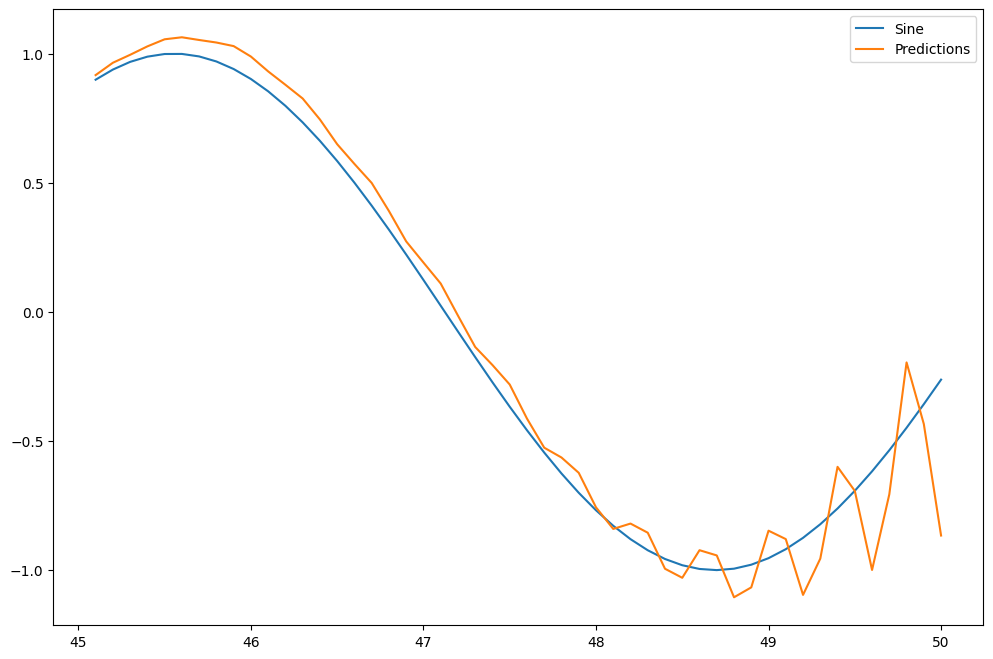

In [14]:
# IGNORE WARNINGS
test['Predictions'] = true_predictions
test.plot(figsize=(12,8))